In [1]:
import pandas as pd
from math import ceil
import numpy as np
import scipy.stats as st
import matplotlib.pyplot as plt
import seaborn as sns
from copy import deepcopy

from scipy.stats import linregress
import statsmodels.api as sm

from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, classification_report, roc_curve, confusion_matrix
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
import warnings
warnings.filterwarnings('ignore')

Задаем функции для дальнейшей работы.

In [2]:
# Функция для комплексной проверки метрик модели логиcтической регресии
def check_metrics_log_regress(x_array_train: np.array, 
                              y_array_train: np.array, 
                              x_array_test: np.array, 
                              y_array_test: np.array):
    """
    Функция для комплексной проверки метрик модели логиcтической регресии: Прогноз на тестовом наборе и расчёт точности,
    матрица ошибок, Основные метрики, ROC-кривая. 
    На вход подаются 4 массива: 2 для обучения и 2 для теста
    """
    # Прогноз на тестовом наборе и расчёт точности:
    print('Прогноз на тестовом наборе и расчёт точности:')
    y_pred = logreg.predict(x_array_test)
    (print('Accuracy of logistic regression classifier on test set: {:.2f}'
           .format(logreg.score(x_array_test, y_array_test))))
    print()
    
    # матрица ошибок
    print('Матрица ошибок:')
    cm = confusion_matrix(y_array_test, y_pred)
    print(cm)
    print()
    
    # посмотрим основные метрики
    print('Основные метрики:')
    print(classification_report(y_array_test, y_pred))
    print()
    
    # ROC-кривая
    print('ROC-кривая')
    logit_roc_auc = roc_auc_score(y_array_test, logreg.predict(x_array_test))
    fpr, tpr, thresholds = roc_curve(y_array_test, logreg.predict_proba(x_array_test)[:,1])
    plt.figure()
    plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Рабочая характеристика')
    plt.legend(loc="lower right")
    plt.savefig('Log_ROC')
    plt.show()

In [3]:
# Функция для вывода ROC AUC отдельных признаков
def roc_auc_individual_features(x_array_train: np.array, y_array_train: np.array):
    """
    Функция для вывода ROC AUC отдельных признаков. 
    На вход подаются 2 массива для обучения.
    Возвращает список неинформативных параметров.
    """
    non_informative = []
    for i in range(x_array_train.shape[1]):
        auc = roc_auc_score(y_array_train, x_array_train[:, i])

        if abs(auc - 0.5) < 0.02:
            print(f"{i} : {auc = :.3f} -> non_informative")
            non_informative.append(i)

        else:
            print(f"{i} : {auc = :.3f}")
    return non_informative

In [4]:
# Функция, которая будет приобразовывать по разному переменную
def show_changes(arr_x: np.array, arr_y: np.array, number_column: str):
    # выведем исходный график
    res = woe_line(arr_x, arr_y, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + number_column + ' without changes', target_nm = 'y ')
    
    # 1 изменение. Преобразуем массив с помощью логарифмирования числа по модулю
    transformed_arr_x = []
    for num in arr_x:
        transformed_arr_x.append(np.log(abs(num)))
    # Выведем преобразованный график
    res = woe_line(transformed_arr_x, arr_y, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + number_column + ' Логарифм по модулю', target_nm = 'y ')
    
    # 2 изменение. Преобразуем массив с помощью взятия квадратного корня по модулю
    transformed_arr_x = []
    for num in arr_x:
        transformed_arr_x.append(np.sqrt(abs(num)))
    # Выведем преобразованный график
    res = woe_line(transformed_arr_x, arr_y, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + number_column + ' Квадратный корень по модулю', target_nm = 'y ')
    
    # 3 изменение. Преобразуем массив с помощью взятия кубического корня по модулю
    transformed_arr_x = []
    for num in arr_x:
        transformed_arr_x.append(np.cbrt(abs(num)))
    # Выведем преобразованный график
    res = woe_line(transformed_arr_x, arr_y, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + number_column + ' Кубический корень по модулю', target_nm = 'y ')
    
    # 4 исзменение. Преобразуем массив с помощью возведения в квадрат
    transformed_arr_x = []
    for num in arr_x:
        transformed_arr_x.append(num ** 2)
    # Выведем преобразованный график
    res = woe_line(transformed_arr_x, arr_y, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + number_column + ' Возведение в квадрат', target_nm = 'y ')
    
    # 5 исзменение. Преобразуем массив с помощью возведения в куб
    transformed_arr_x = []
    for num in arr_x:
        transformed_arr_x.append(num ** 3)
    # Выведем преобразованный график
    res = woe_line(transformed_arr_x, arr_y, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + number_column + ' Возведение в куб', target_nm = 'y ')
    
    # 6 исзменение. Преобразуем массив с помощью возведения в -1 степень 
    transformed_arr_x = []
    for num in arr_x:
        transformed_arr_x.append(num ** (-1))
    # Выведем преобразованный график
    res = woe_line(transformed_arr_x, arr_y, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + number_column + ' Возведение в -1 степень', target_nm = 'y ')
    
    # 7 исзменение. Преобразуем массив с помощью возведения в -2 степень 
    transformed_arr_x = []
    for num in arr_x:
        transformed_arr_x.append(num ** (-2))
    # Выведем преобразованный график
    res = woe_line(transformed_arr_x, arr_y, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + number_column + ' Возведение в -2 степень', target_nm = 'y ')

In [5]:
# Фуекция для RandomizedSearchCV
def RandomizedSearchCV_params(rfc, x_array_train: np.array, y_array_train: np.array):
    """
    Функция принимает: 
    rfc - заданную модель Random Forest,
    x_array_train - массив с фичами для обучения,
    y_array_train - массив с 0 и 1 для обучения.
    
    Функция возвращает:
    rs_df - результаты работы алгоритма RandomizedSearchCV в виде датафрейма
    """
    n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
    max_features = ['log2', 'sqrt']
    max_depth = [int(x) for x in np.linspace(start = 1, stop = 15, num = 15)]
    min_samples_split = [int(x) for x in np.linspace(start = 2, stop = 50, num = 10)]
    min_samples_leaf = [int(x) for x in np.linspace(start = 2, stop = 50, num = 10)]
    bootstrap = [True, False]
    param_dist = {'n_estimators': n_estimators,
                   'max_features': max_features,
                   'max_depth': max_depth,
                    'min_samples_split': min_samples_split,
                   'min_samples_leaf': min_samples_leaf,
                   'bootstrap': bootstrap}
    rs = RandomizedSearchCV(rfc, 
                            param_dist, 
                            n_iter = 100, 
                            cv = 3, 
                            verbose = 1, 
                            n_jobs=-1, 
                            random_state=0)
    rs.fit(x_array_train, y_array_train)
    print(rs.best_params_)
    rs_df = pd.DataFrame(rs.cv_results_).sort_values('rank_test_score').reset_index(drop=True)
    rs_df = rs_df.drop([
            'mean_fit_time', 
            'std_fit_time', 
            'mean_score_time',
            'std_score_time', 
            'params', 
            'split0_test_score', 
            'split1_test_score', 
            'split2_test_score', 
            'std_test_score'],
            axis=1)
    return rs_df

# Логистическая регрессия и случайный лес

В задании вам предстоит пооработать с базовыми инструментами построения логистической регрессии:
* визуализация
* разбиение данных на обучающую и тестовую выборки
* преобразование переменных
* отбор переменных
* построение итоговой модели и валидация

Далее вы построите случайный лес и сравните два класса моделей. Все это будет на сгенерированных данных.

## Сгенерируем данные

In [6]:
X, y = make_classification(n_samples=7000, 
                           n_features=20, # Общее количество характеристик
                           n_informative=5, # неинформативные 
                           n_redundant=2, # Кол-во избыточных функций(генерируются как случайные линейные комбинации информативных признаков)
                           n_repeated=0, # Кол-во повторяющихся признаков, выбранных случайным образом из информативных и избыточных признаков
                           scale=None, shift=None, shuffle=False, 
                           class_sep=0.5, 
                           random_state=40)

Разбивка на train и test нужна для того, чтобы оставить часть данных нетронутой для проверки

Модель мы будем применять на данных, которые еще не видели, и разбивка позволяет нам хоть немного имитировать этот процесс. Выборка бьется последовательным применением train_test_split

Стандартные пропорции: 70:30 в случае с train/test, 60:20:20 в случае с train/val/test

In [7]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

In [8]:
# Продублируем для леса
X_train_f = deepcopy(X_train)
X_test_f = deepcopy(X_test)

## Можно визуализировать зависимости, посмотреть на характер данных

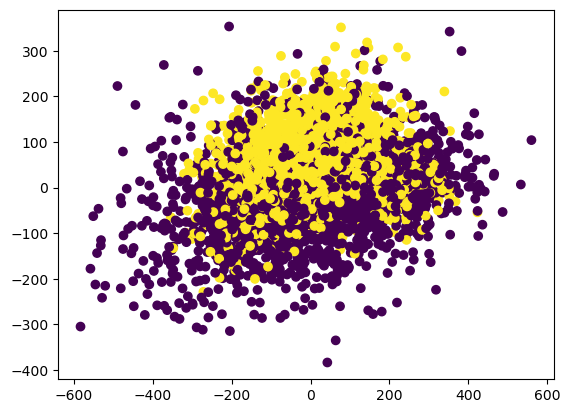

In [9]:
plt.scatter(X_train[:, 0], X_train[:, 1], c=y_train)
plt.show()

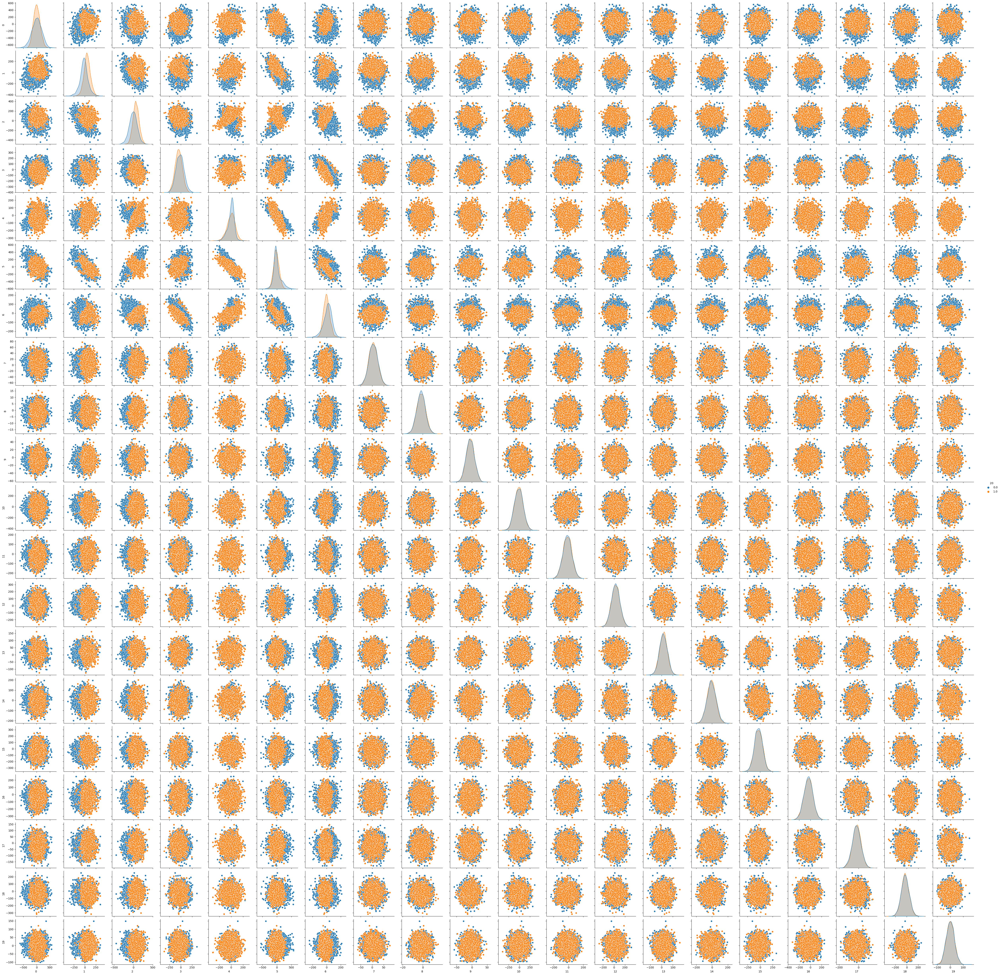

In [10]:
sns.pairplot(pd.DataFrame(np.append(X, y[:, np.newaxis], axis = 1)), hue=20)

Из пейрплота видно, что только первые 7 признаков информативны для разделения наблюдений на 2 класса.

<AxesSubplot:>

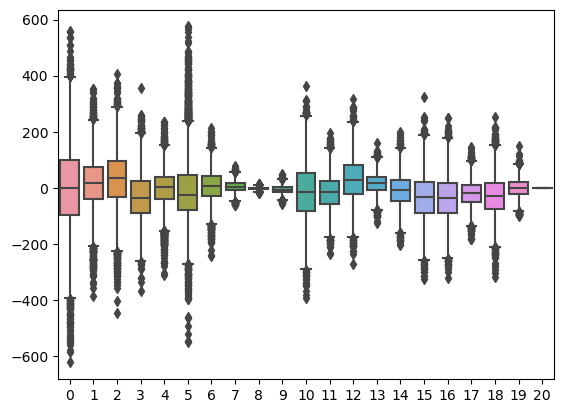

In [11]:
sns.boxplot(data=pd.DataFrame(np.append(X, y[:, np.newaxis], axis = 1)))

В данных достаточно много аутлайеров (выбросов). Если бы это были реальные данные, важно было бы проверить что это за значения, возможно их исключить.

Первично анализировать признаки удобно с помощью woe_line.

Функция делит наблюдения на группы по $X$, для каждой группы считает WoE, и откладывает эти значения на графике.

# Анализ данных

## Подготовка

## Задание 1

Написать функцию woe_line:

1. разбить наблюдения на n_buckets групп по $X$
2. в каждой группе по y отложить WoE, по x медианное значение $X$
3. вывести полученный график
4. вывести ROC AUC признака (sklearn.metrics.roc_auc_score)
5. Опционально. Рассчитать доверительный интервал для bad rate (bad rate - доля наблюдений с целевой переменной =1 от всех наблюдений в группе)
6. Опционально. Нанести на график линейное приближение любым способом

График позволит проверить линейность зависимости, силу переменной, опционально проверить распределение

In [12]:
def woe_line(X,         # 1-мерный массив с независимым признаком
             y,         # 1-мерный массив с целевым признаком
             n_buckets, # количество корзин для построения
             var_nm = None,    # опционально, название переменной для отображения над графиком
             target_nm = None, # опционально, название целевой переменной для отображения над графиком
             clip = None,      
             plot_hist= None): # опционально, если True — отображается гистограмма X
    if plot_hist:
        # Построение гистограммы X с указанным количеством корзин
        plt.hist(X, bins = n_buckets, color = 'skyblue') 
        plt.twinx()  # Добавление второй оси y для гистограммы
        
    # Расчет woe для всего массива данных
    woe_all_arr = np.log((sum(y)/len(y))/((len(y)-sum(y))/len(y)))
    
    # Отбор значений X и y в соответствии с ограничениями clip (если они заданы)
    x_y = [(a, b) for a, b in zip(X, y) if clip[0] <= a <= clip[1]] if clip else [(a, b) for a, b in zip(X, y)]
    x_y.sort(key=lambda x: x[0])  # Сортировка значений X и y по возрастанию значения X
    
    # Определение индекса для разделения массива на корзины
    ind_bucket = ceil(len(x_y)/n_buckets)
    # Разделение значений X и y на корзины с помощью генератора списков
    buckets = np.array([np.array(x_y[ind_bucket * i :ind_bucket*(i+1)]) for i in range(n_buckets)], dtype=object)
        
    # Сбор woe и bad_rate для каждой корзины
    woe, bad_rate = [], []
    
    # Вычисление woe для каждой корзины
    for buck in buckets:
        ones = buck[:, 1].sum()  # Сумма значений y (класс "1") в текущей корзине
        # Расчет доли класса "1" (o) и класса "0" (z) в текущей корзине
        o, z = ones/len(buck),  (len(buck)-ones)/len(buck)
        # Ограничение значений o и z, чтобы избежать бесконечности при расчете woe
        if o == 0:
            o = 0.001
        elif o == 1:
            o = 0.999
        if z == 0:
            z = 0.001
        elif z == 1:
            z = 0.999
        bad_rate.append(o)
        # Расчет woe для текущей корзины
        bucket_woe = np.log(o/z) - woe_all_arr
        woe.append(round(bucket_woe, 3))  # Округление значения woe до трех знаков после запятой
    
    # Настройки графика
    plt.grid()  # Отображение сетки на графике
    plt.xlabel("Feature value", loc='center')  # Установка подписи оси x
    plt.ylabel("Woe", loc='center')  # Установка подписи оси y
    
    # Вычисление среднего значения для каждой корзины
    buck_mean = [np.median(b[:, 0], axis=0) for b in buckets]
    
    # Линия интерполяции
    model = LinearRegression()
    model.fit(np.array(buck_mean).reshape((-1, 1)), woe)  # Обучение модели линейной регрессии
    
    if plot_hist:
        interpolation_line = model.intercept_ + model.coef_ * [min(X), max(X)]
        plt.plot([min(X), max(X)], interpolation_line)  # Построение линии интерполяции на гистограмме
    else:
        interpolation_line = model.intercept_ + model.coef_ * buck_mean
        plt.plot(buck_mean, interpolation_line)  # Построение линии интерполяции на основе средних значений корзин
    
    # Расчет ошибки
    def buck_std(buck):
        sum_ = sum([(el - y.mean())**2 for el in buck[:, 1]])
        std = (sum_ / len(buck))**0.5
        return sum_
    
    error = [1.96 * buck_std(buck) / (2 * len(buck)) for buck in buckets]  # Расчет ошибки по корзинам
    
    # Доверительный интервал для bad rate
    conf_bad_rate = st.t.interval(0.95, len(bad_rate) - 1, loc=np.mean(bad_rate), scale=st.sem(bad_rate))
    
    plt.errorbar(buck_mean, woe, fmt='o', yerr=error, lw=1, capsize=2, capthick=2,
                 color='red', linestyle='--')  # Отображение точек с ошибками на графике
    plt.legend(['interpolation', 'Woe'])  # Добавление легенды на график
    
    # Расчет ROC AUC
    auc = roc_auc_score(y, X) 
    
    # Форматирование заголовка графика с использованием значений var_nm, target_nm, auc и conf_bad_rate
    plt.title(f'{var_nm}|{target_nm} AUC: {auc:.2f}, conf bad rate ({conf_bad_rate[0]:.2f}, {conf_bad_rate[1]:.2f})')
    plt.show() 

## Анализ каждой переменной

При преобразовании переменных важно соблюдать баланс:

1. переменная должна стать линейной,
2. не стоит доводить до идеальной линейности в ущерб разделяющей силы (ROC AUC),
3. в работе с реальными данными стоит обращать внимание на физический смысл переменных. Например, в случае с размерными переменными (рубли, метры), часто помогает взятие корня или логарифма, а еще лучше приводить их к безразмерным величинам нормировкой.

## Задание 2

1. проверить каждую переменную на woe_line,
2. каждую полезную переменную линеаризовать (для каждой переменной нужны графики ДО и ПОСЛЕ),
3. ненужные переменные (слабые по ROC AUC, немонотонные) исключить из модели,
4. на отобранных и линеаризованных переменных построить модель, проверить результат на test по ROC AUC.

### Построение логистической регрессии на сырых данных

In [13]:
# реализуем модель на сырых данных
logit_model=sm.Logit(y,X, random_state=42) # зададим начальное состояние генератора случайных чисел
result=logit_model.fit()
print(result.summary2())

         Current function value: 0.504514
         Iterations: 35
                         Results: Logit
Model:              Logit            Pseudo R-squared: 0.272    
Dependent Variable: y                AIC:              7101.1977
Date:               2023-06-13 19:43 BIC:              7231.4173
No. Observations:   7000             Log-Likelihood:   -3531.6  
Df Model:           18               LL-Null:          -4852.0  
Df Residuals:       6981             LLR p-value:      0.0000   
Converged:          0.0000           Scale:            1.0000   
No. Iterations:     35.0000                                     
----------------------------------------------------------------
         Coef.   Std.Err.     z    P>|z|     [0.025     0.975]  
----------------------------------------------------------------
x1       0.0102  2009.8380  0.0000 1.0000  -3939.1998  3939.2202
x2       0.0323  8946.9875  0.0000 1.0000 -17535.7409 17535.8055
x3      -0.0541  1008.9564 -0.0001 1.0000  -1977.

p-значение большинства переменных больше 0,05, кроме 1х - 7х.


Прогноз на тестовом наборе и расчёт точности:
Accuracy of logistic regression classifier on test set: 0.74

Матрица ошибок:
[[778 278]
 [269 775]]

Основные метрики:
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      1056
           1       0.74      0.74      0.74      1044

    accuracy                           0.74      2100
   macro avg       0.74      0.74      0.74      2100
weighted avg       0.74      0.74      0.74      2100


ROC-кривая


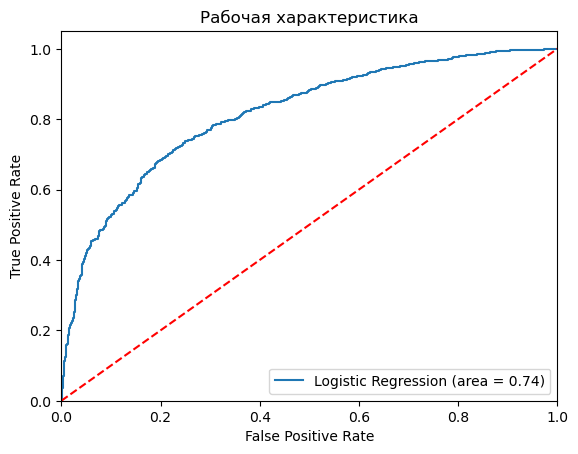

In [14]:
# Обучение модели логистической регрессии на сырых данных
logreg = LogisticRegression()
logreg.fit(X_train, y_train)

# посмотрим метрики
check_metrics_log_regress(X_train, y_train, X_test, y_test)

На сырых данных ROC AUC 0.74.

### Проверим на мультиколлениарность

Посмотрим на ROC AUC всех признаков

In [17]:
non_informative = roc_auc_individual_features(X_train, y_train)

0 : auc = 0.495 -> non_informative
1 : auc = 0.743
2 : auc = 0.714
3 : auc = 0.404
4 : auc = 0.501 -> non_informative
5 : auc = 0.466
6 : auc = 0.387
7 : auc = 0.493 -> non_informative
8 : auc = 0.508 -> non_informative
9 : auc = 0.504 -> non_informative
10 : auc = 0.496 -> non_informative
11 : auc = 0.506 -> non_informative
12 : auc = 0.495 -> non_informative
13 : auc = 0.502 -> non_informative
14 : auc = 0.492 -> non_informative
15 : auc = 0.493 -> non_informative
16 : auc = 0.503 -> non_informative
17 : auc = 0.503 -> non_informative
18 : auc = 0.497 -> non_informative
19 : auc = 0.505 -> non_informative


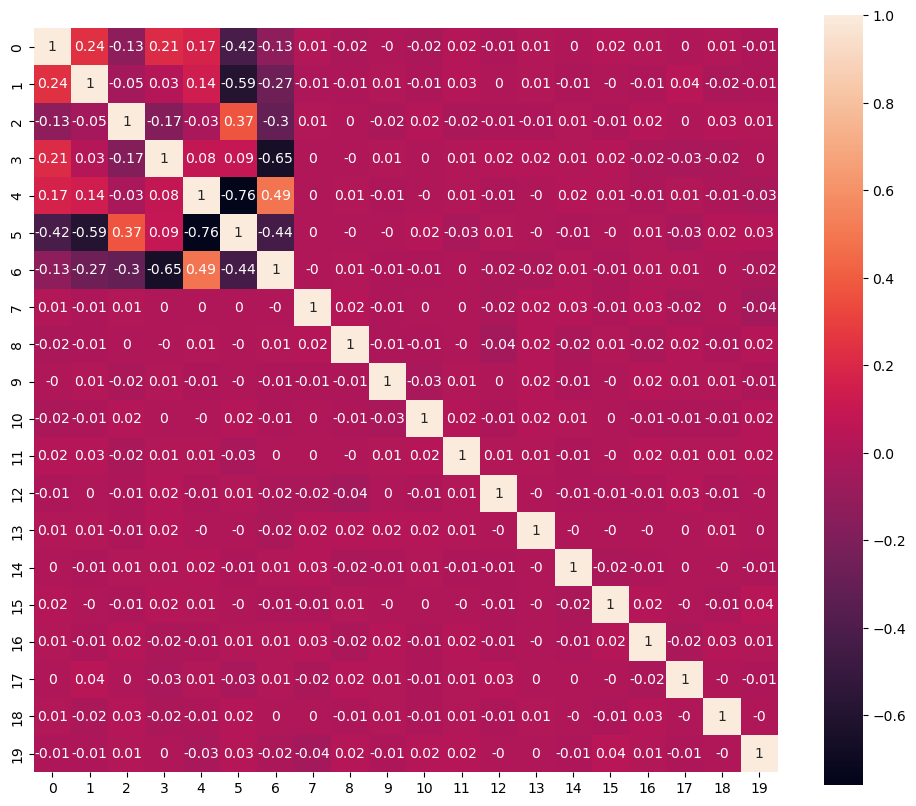

In [18]:
# построим матрицу корреляции 
fig, ax = plt.subplots()
sns.heatmap(pd.DataFrame(X_train).corr().round(2), annot = True, square=True)
fig.set_figheight(10) # высота 
fig.set_figwidth(12) # ширина

При генерации данных был задан параметр n_redundant=2 - это кол-во избыточных функций (генерируются как случайные линейные комбинации информативных признаков). Удалим 2 признака с высокой корреляцией - это столбцы с индексами 5 и 6. 

In [19]:
# Удаление столбцов с индексами 5 и 6
X_train = np.delete(X_train, [5, 6], axis=1)
X_test = np.delete(X_test, [5, 6], axis=1)

### Проверим каждую переменную на woe_line

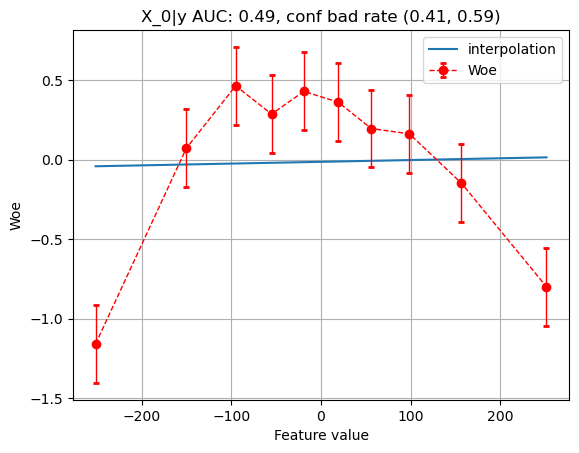

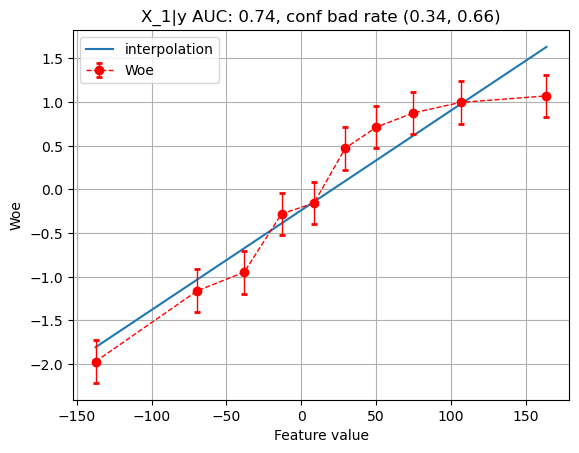

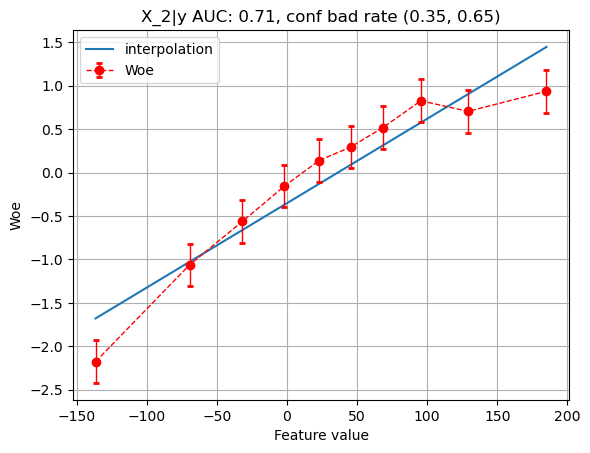

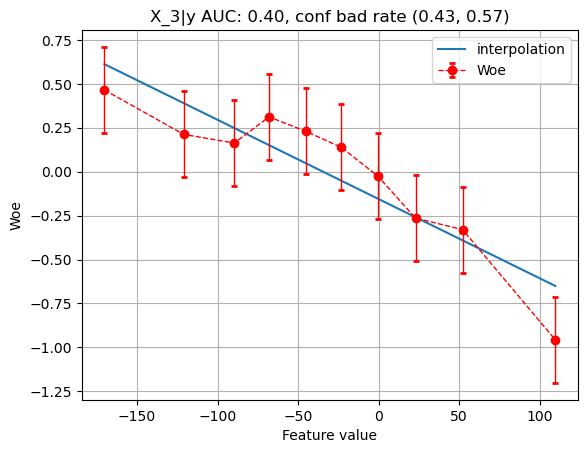

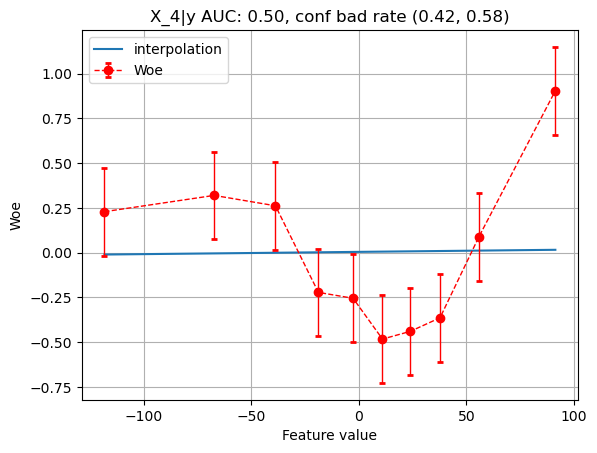

...

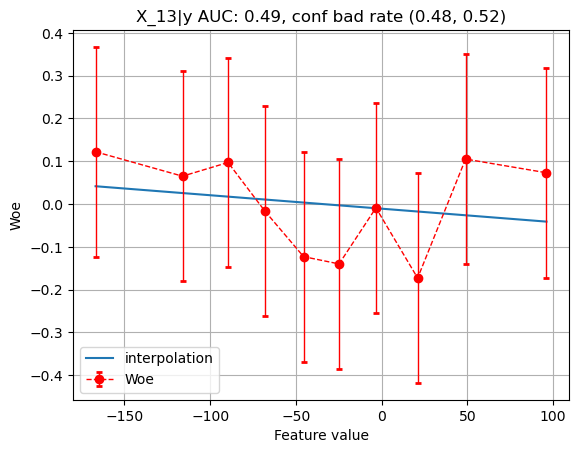

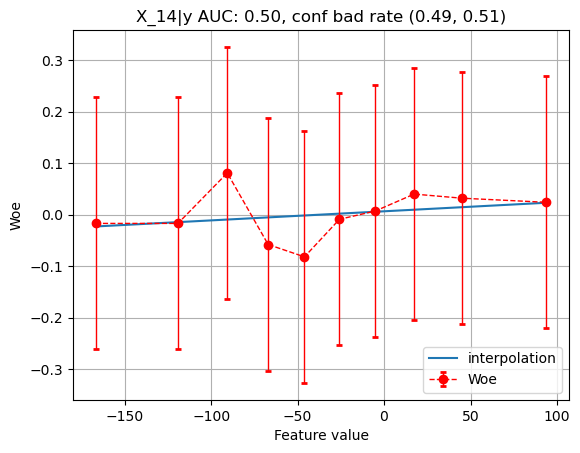

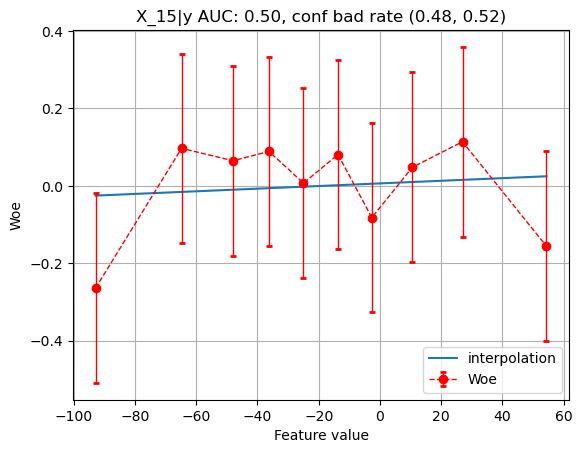

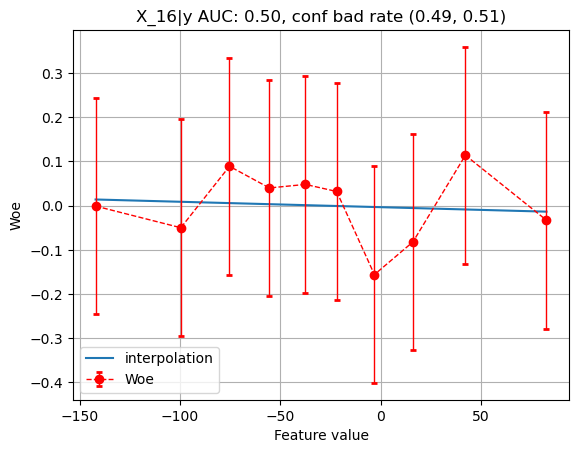

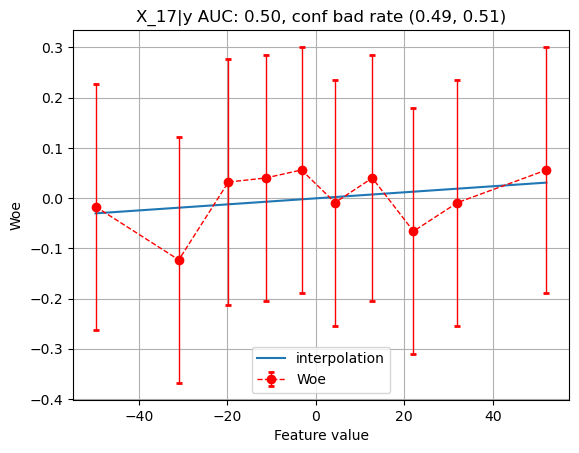

In [20]:
for i in range(X_train.shape[1]):
    woe_line(X_train[:, i], y_train, n_buckets=10, plot_hist=False, 
               var_nm = 'X_' + str(i), target_nm = 'y')

### Линеарезация полезных переменных

У нас есть 3 информативных признака, преобразуем их и остальные, чтобы изменить ROC AUC и найти еще 2 информативные переменные.

Преобразуем столбец с индексом 0.

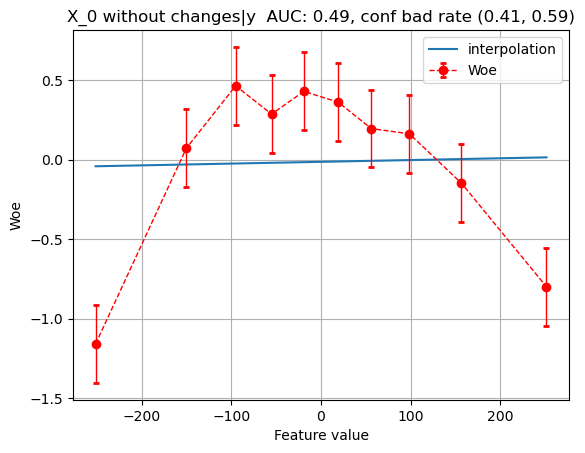

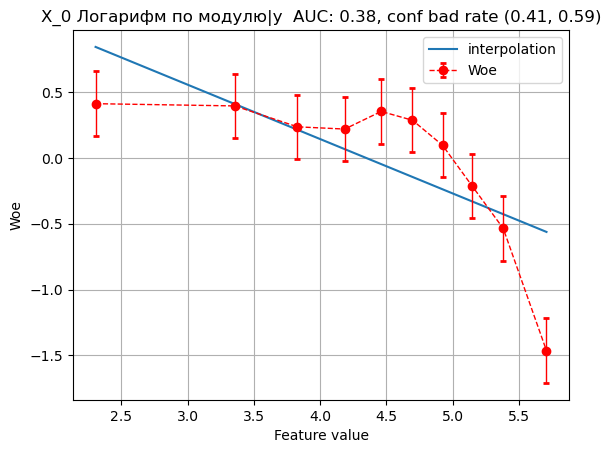

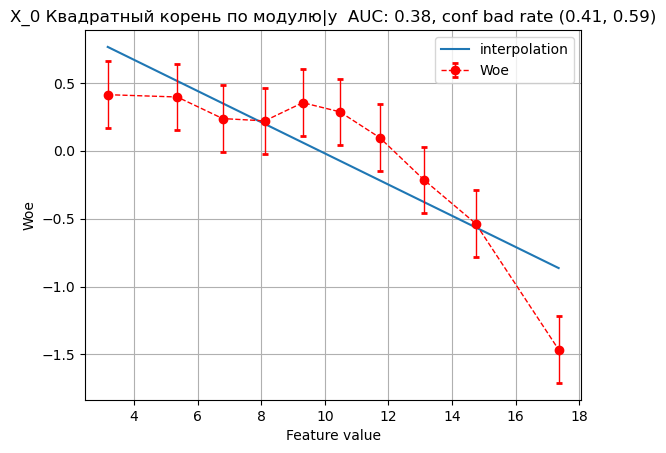

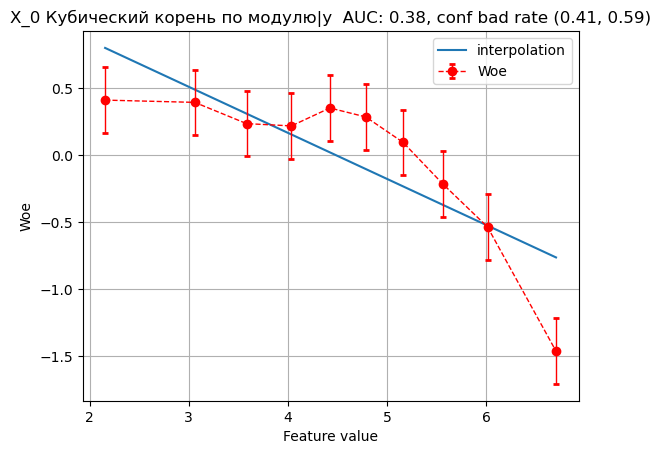

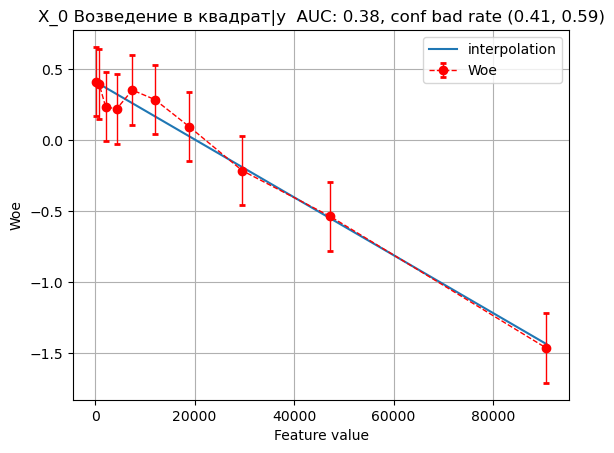

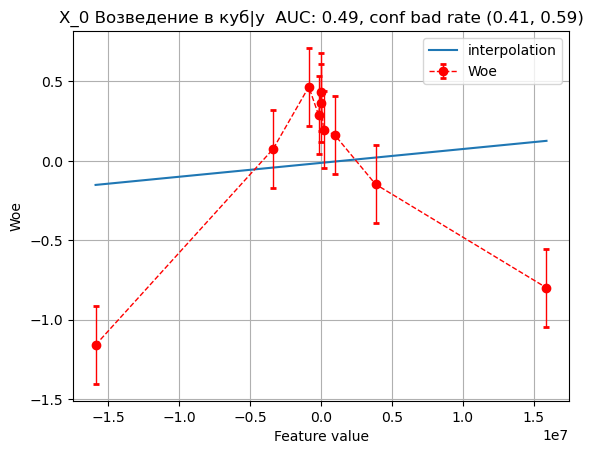

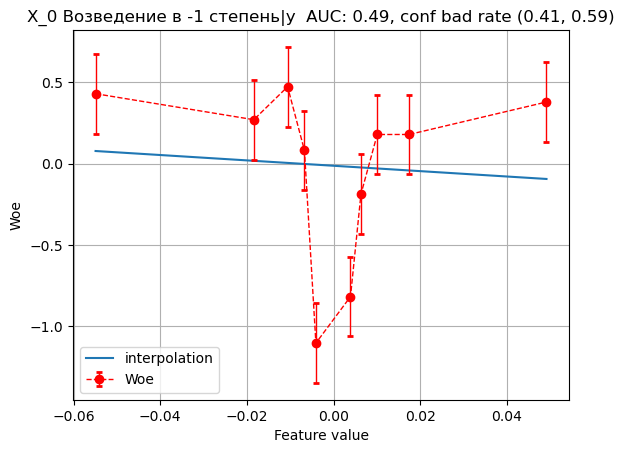

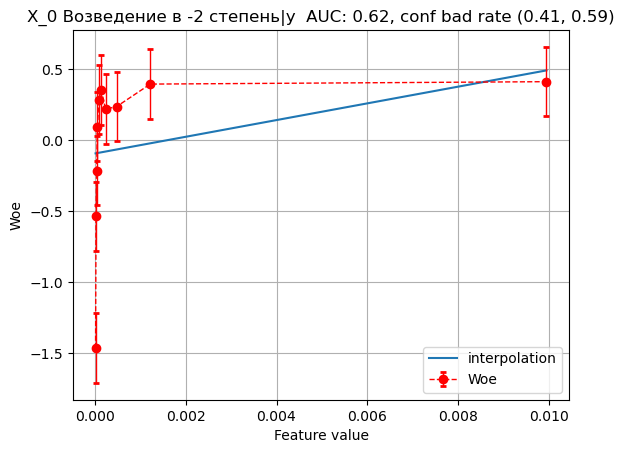

In [22]:
show_changes(X_train[:, 0], y_train, number_column = '0')

Преобразуем переменную с помощью возведения в квадрат, будем использовать в модели.

In [23]:
# преобразуем X_train[:, 0] и X_test[:, 0] с помощью возведения в квадрат
X_train[:, 0] = np.power(X_train[:, 0], 2)
X_test[:, 0] = np.power(X_test[:, 0], 2)

Преобразуем столбец с индексом 1

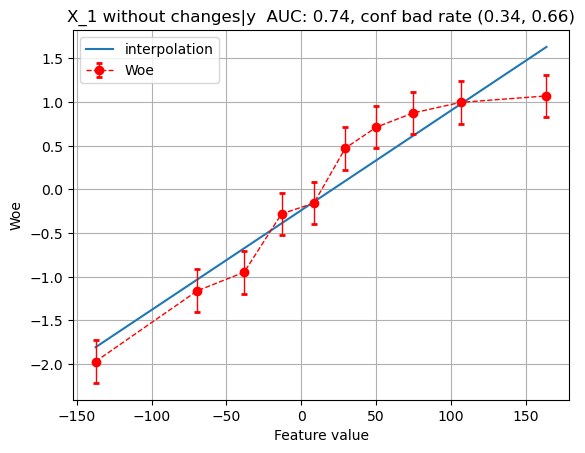

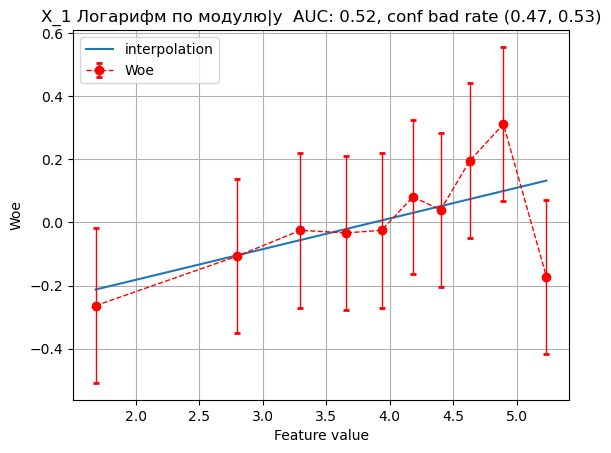

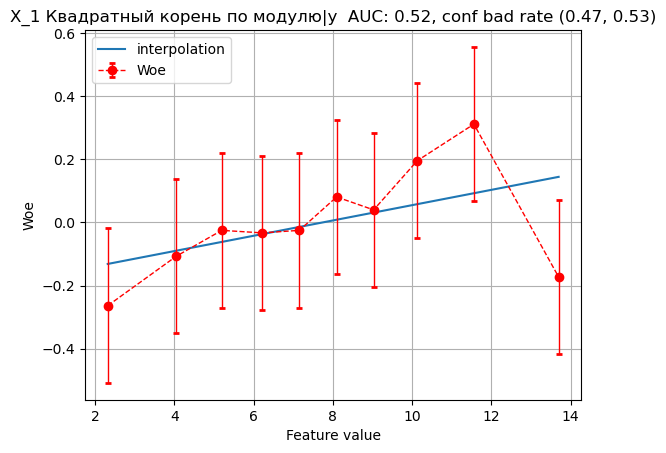

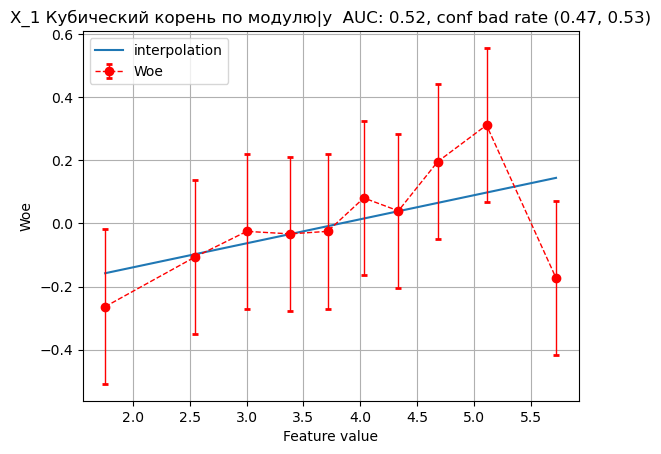

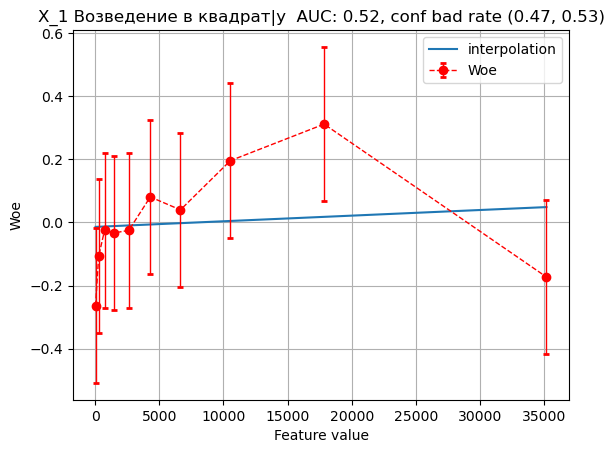

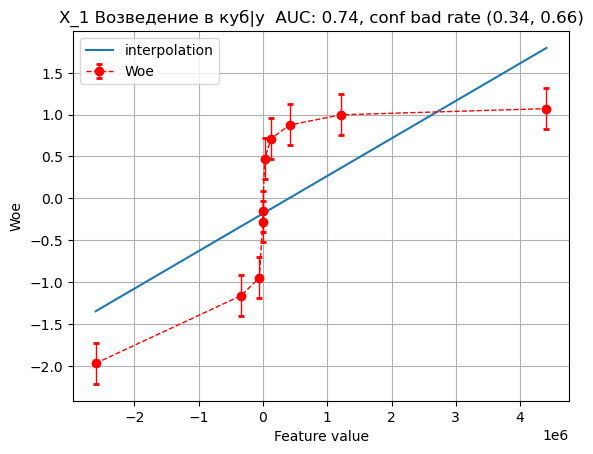

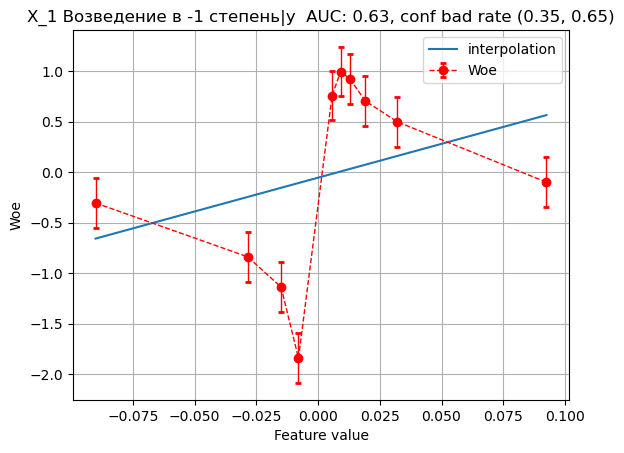

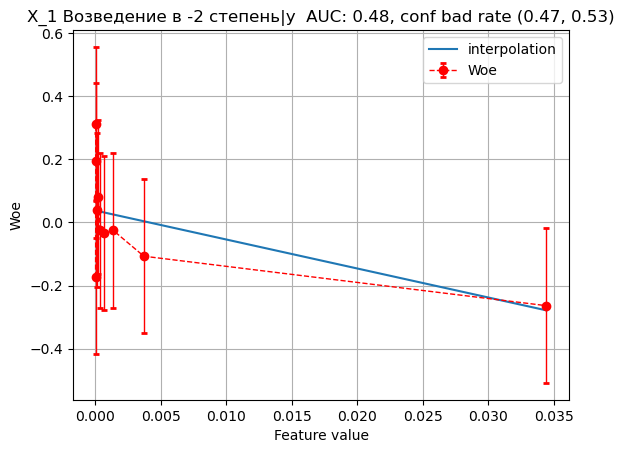

In [24]:
show_changes(X_train[:, 1], y_train, number_column = '1')

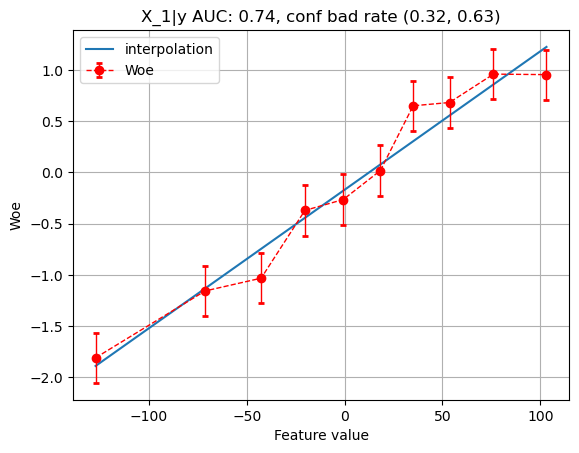

In [25]:
# итоговый график колонки 1
woe_line(X_train[:, 1], y_train, n_buckets=10, plot_hist=False, 
               var_nm = 'X_1', target_nm = 'y', clip=[-200, 120])

Арифметические операции не улучшили ситуацию, обрежем отходящий правый хвостик. Ограничим значения 120, будем использовать в модели.

In [26]:
# преобразуем X_train[:, 1] и X_test[:, 1] ограничим значения справа 120
X_train[:, 1] = np.clip(X_train[:, 1], -150, 120)
X_test[:, 1] = np.clip(X_test[:, 1], -150, 120)

Преобразуем столбец с индексом 2

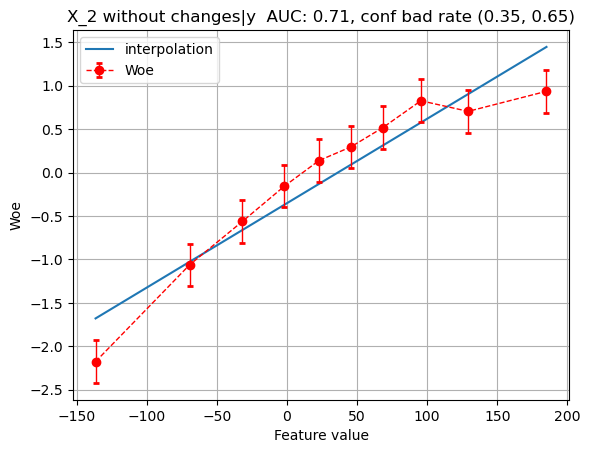

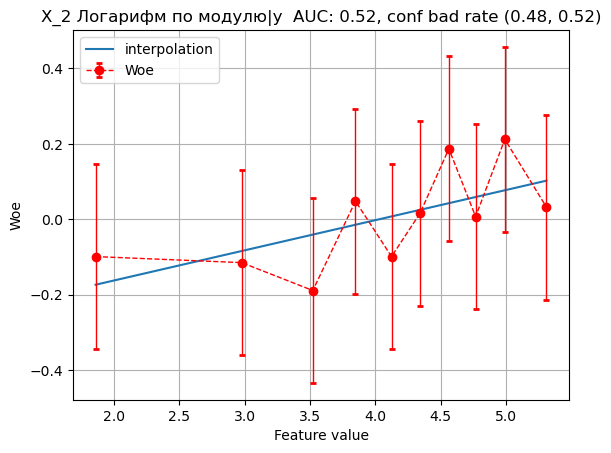

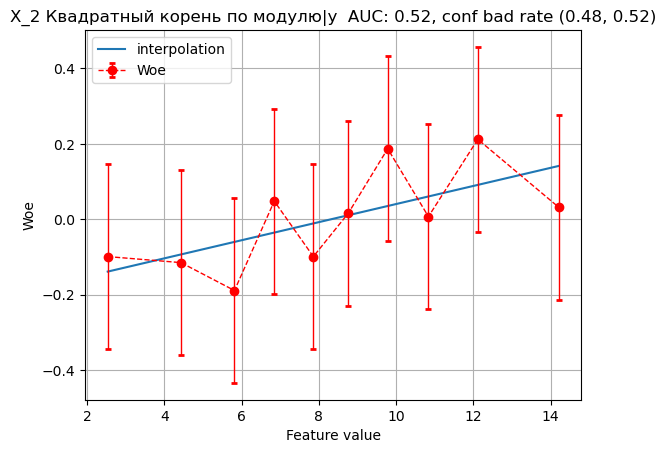

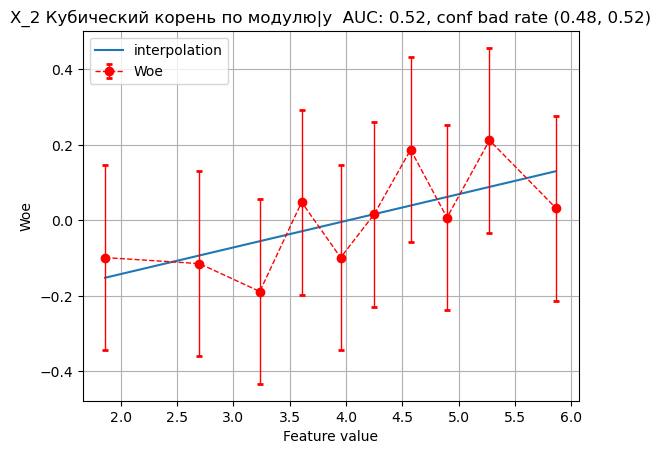

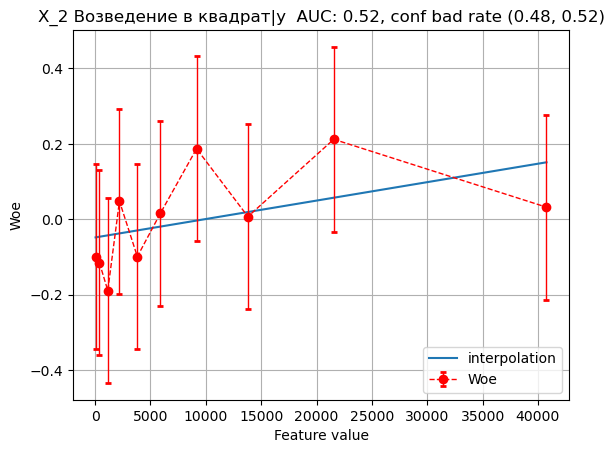

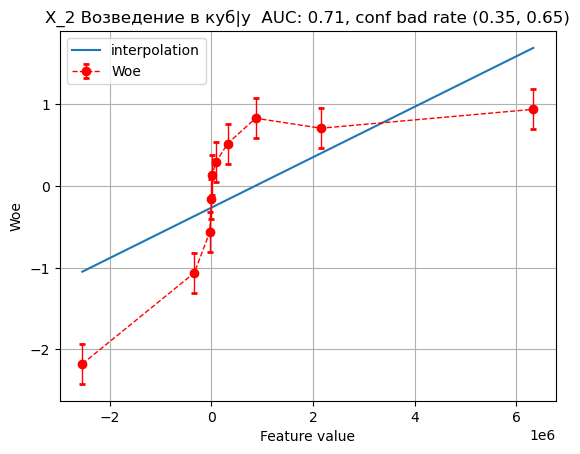

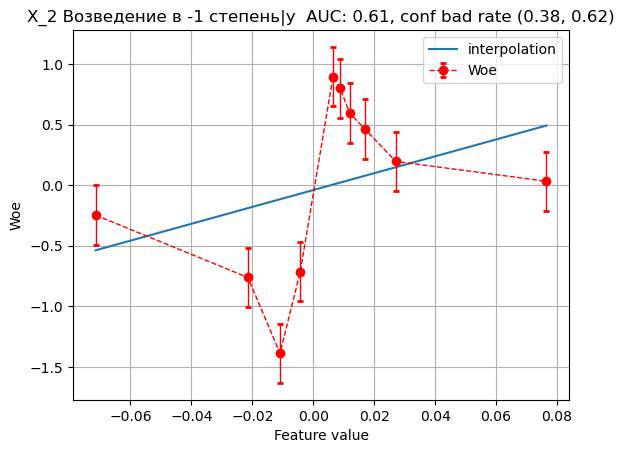

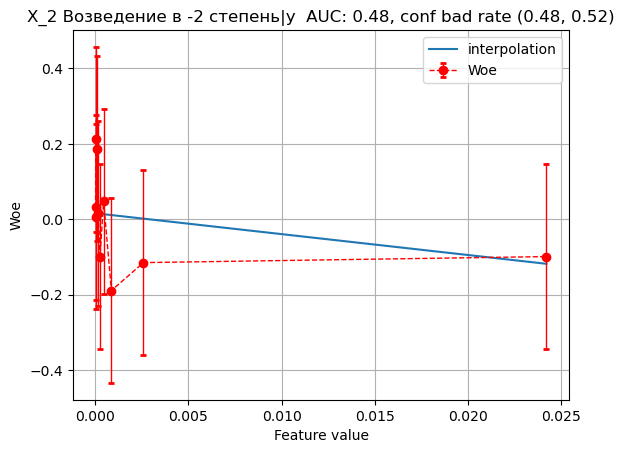

In [27]:
show_changes(X_train[:, 2], y_train, number_column = '2')

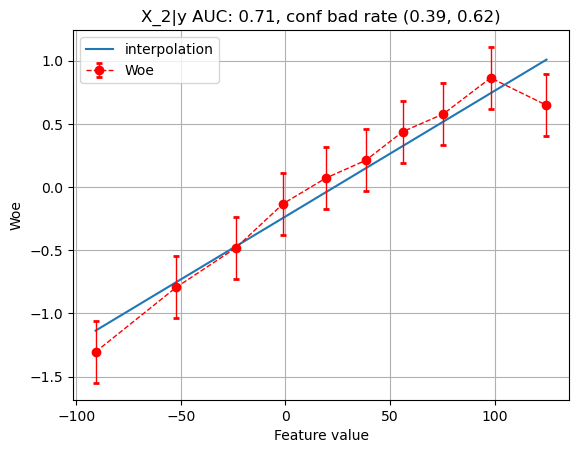

In [28]:
# итоговый график колонки 2
woe_line(X_train[:, 2], y_train, n_buckets=10, plot_hist=False, 
               var_nm = 'X_2', target_nm = 'y', clip=[-120, 140])

Арифметические операции не улучшили ситуацию, обрежем отходящие хвостики. Ограничим значения слева -120 и справа 140, будем использовать в модели.

In [29]:
# преобразуем X_train[:, 2] и X_test[:, 2] ограничим значения слева -120 и справа 140
X_train[:, 2] = np.clip(X_train[:, 2], -120, 140)
X_test[:, 2] = np.clip(X_test[:, 2], -120, 140)

Преобразуем столбец с индексом 3

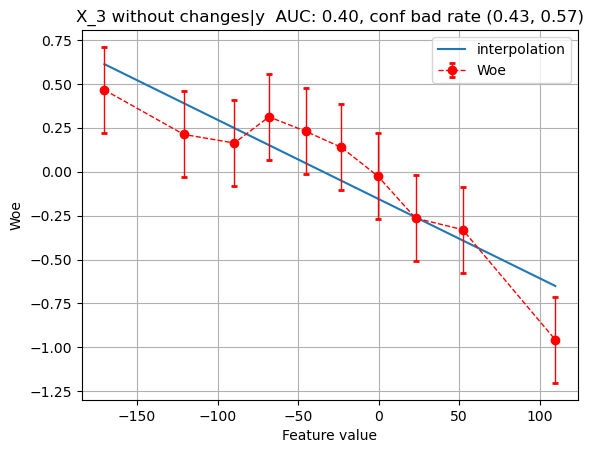

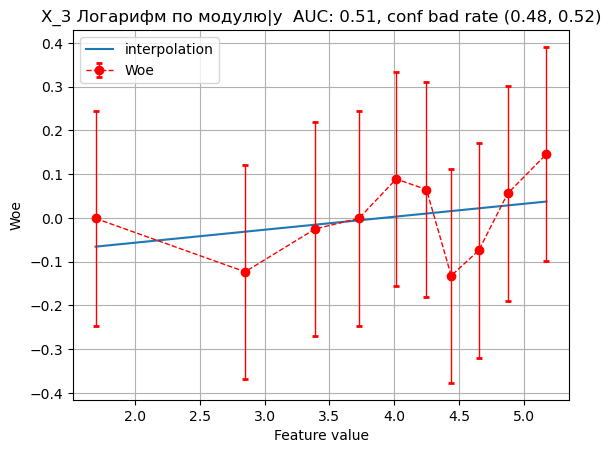

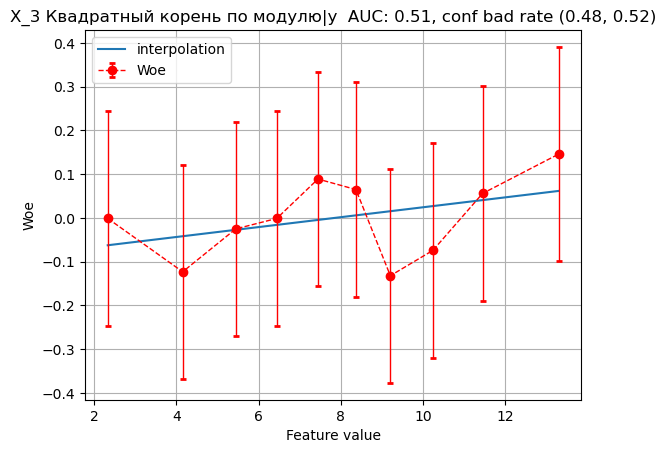

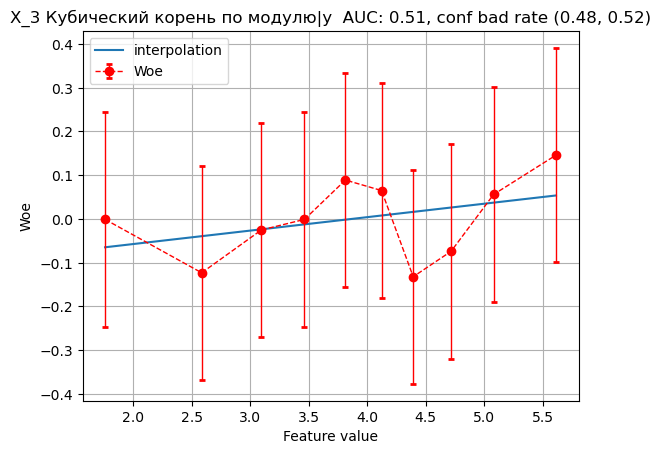

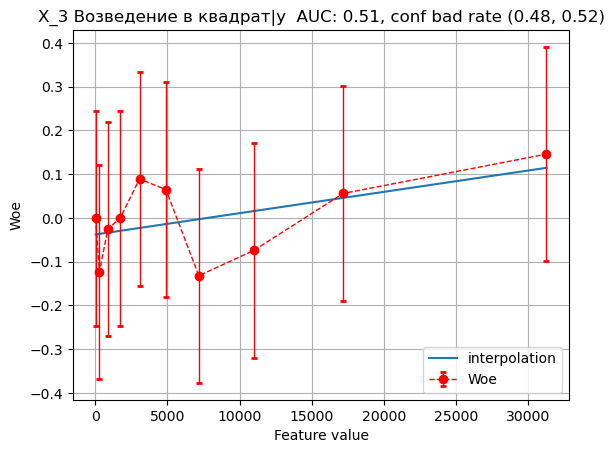

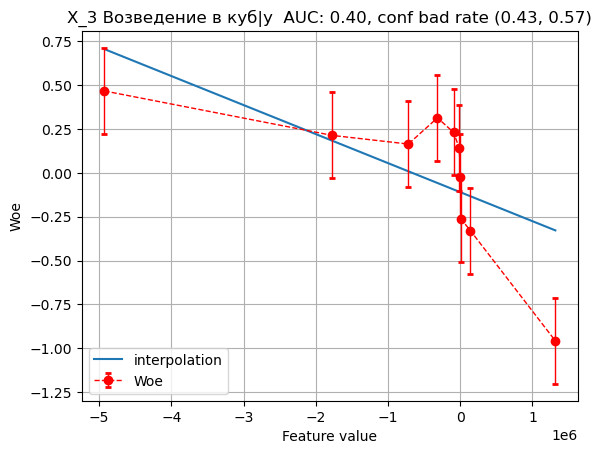

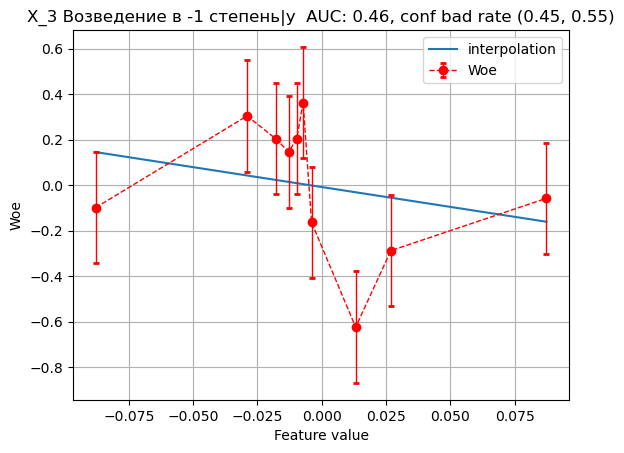

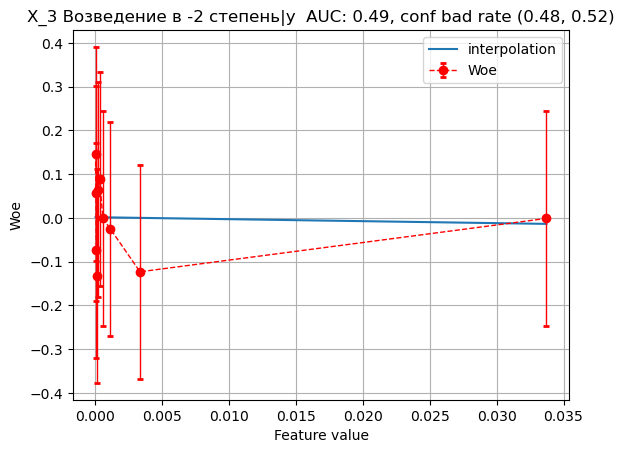

In [30]:
show_changes(X_train[:, 3], y_train, number_column = '3')

Арифметические операции не улучшили ситуацию, оставимм без изменения, будем использовать в модели.

Преобразуем столбец с индексом 4

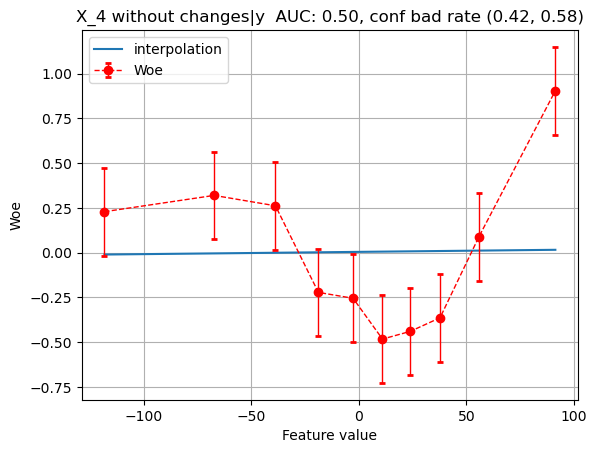

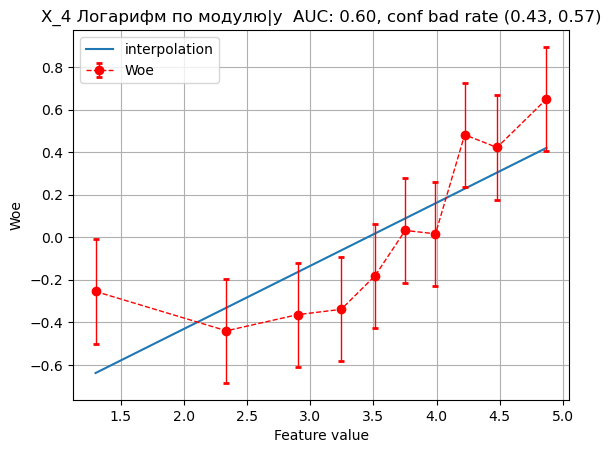

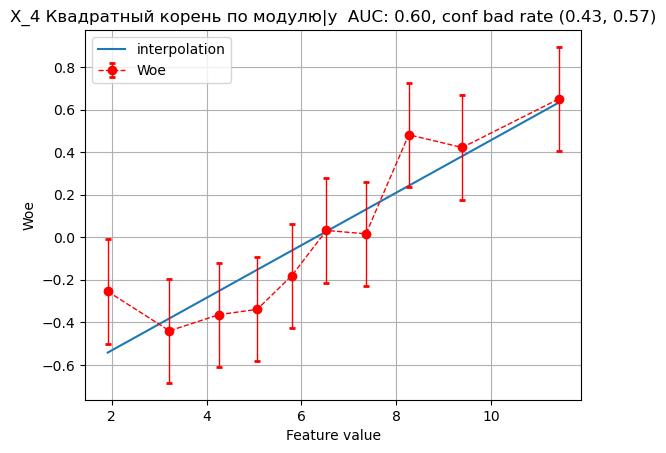

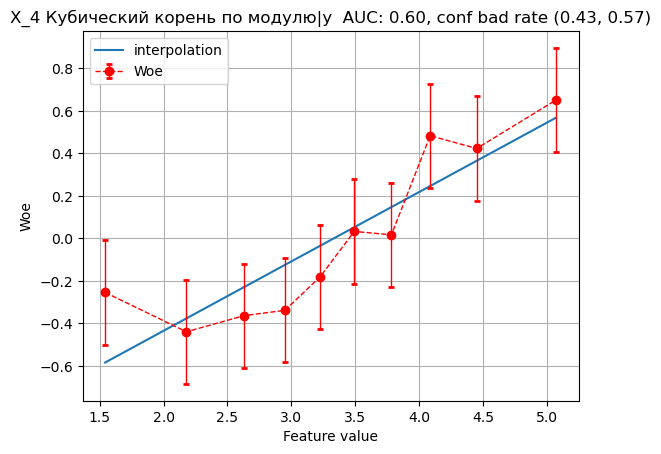

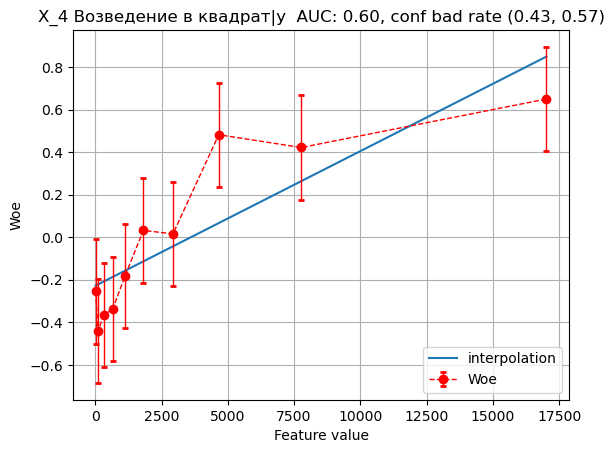

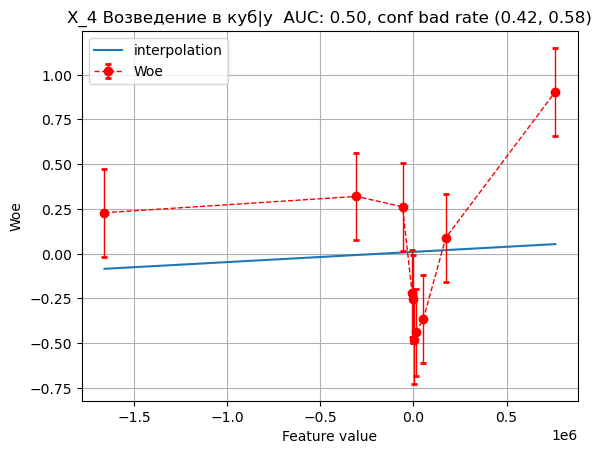

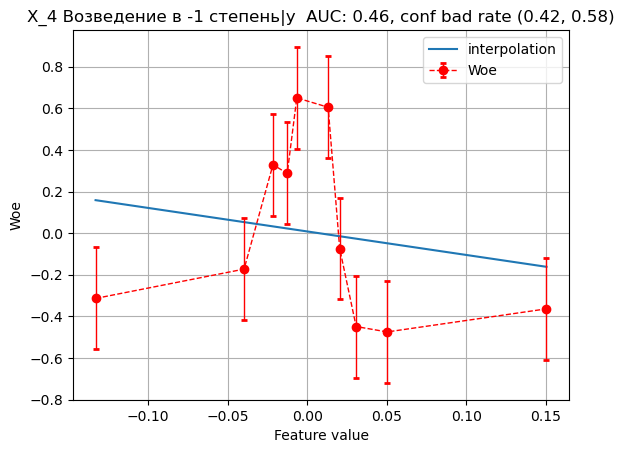

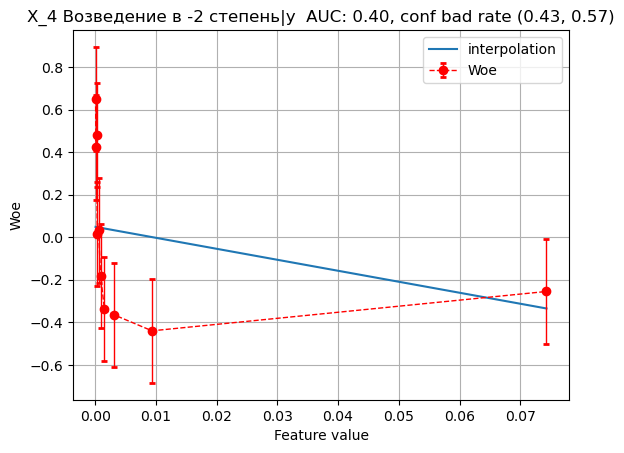

In [31]:
show_changes(X_train[:, 4], y_train, number_column = '4')

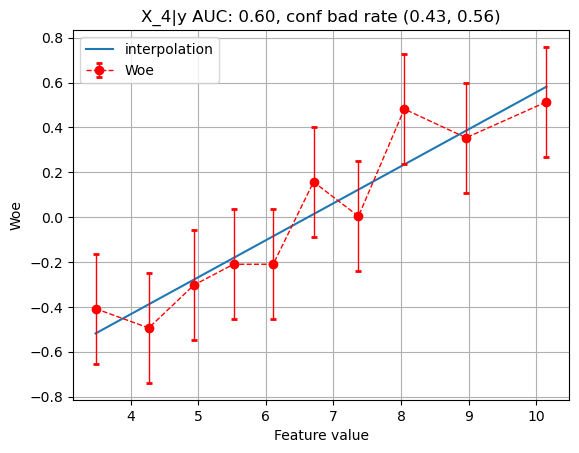

In [32]:
# итоговый график колонки 4
woe_line(np.sqrt(np.abs(X_train[:, 4])), y_train, n_buckets=10, plot_hist=False, 
               var_nm = 'X_4', target_nm = 'y', clip=[3, 11])

4 по индексу колонку преобразуем с помощью квадратного корня по модулю и обрежем слева до значения 3, будем использовать в модели.

In [33]:
# преобразуем X_train[:, 4] и X_test[:, 4] с помощью 2 корня по модулю и обрежем слева до значения 3
X_train[:, 4] = np.clip(np.sqrt(np.abs(X_train[:, 4])), 3, 11)
X_test[:, 4] = np.clip(np.sqrt(np.abs(X_test[:, 4])), 3, 11)

Так как мы нашли 5 информативных признаков. Признаки с индексами 5-17 не информативны, исключим их из модели.

In [35]:
# Удаление столбцов с индексами 5-17
X_train = np.delete(X_train, np.s_[5:18], axis=1)
X_test = np.delete(X_test, np.s_[5:18], axis=1)

В итоге из начального массива X мы берем для модели столбцы 0,1,2,3,4.

# Построение логистической регрессии

In [36]:
# Теперь реализуем модель на столбцах 1x - 5x
# Выбираем только нужные столбцы из результатов
coef = result.params[:5]
std_err = result.bse[:5]

# Создаем новую модель с выбранными столбцами
X_selected = X[:, :5]
logit_model_selected = sm.Logit(y, X_selected, random_state=42) # зададим начальное состояние генератора случайных чисел)

# Фитим модель на выбранных столбцах
result_selected = logit_model_selected.fit(max_iter=1000) # установила кол-во итераций, чтобы модель сошлась

# Выводим результаты
print(result_selected.summary2())

Optimization terminated successfully.
         Current function value: 0.537042
         Iterations 5
                         Results: Logit
Model:              Logit            Pseudo R-squared: 0.225    
Dependent Variable: y                AIC:              7528.5929
Date:               2023-06-13 19:44 BIC:              7562.8612
No. Observations:   7000             Log-Likelihood:   -3759.3  
Df Model:           4                LL-Null:          -4852.0  
Df Residuals:       6995             LLR p-value:      0.0000   
Converged:          1.0000           Scale:            1.0000   
No. Iterations:     5.0000                                      
------------------------------------------------------------------
          Coef.    Std.Err.      z      P>|z|     [0.025    0.975]
------------------------------------------------------------------
x1       -0.0007     0.0002   -3.5003   0.0005   -0.0010   -0.0003
x2        0.0116     0.0004   31.0949   0.0000    0.0109    0.0124
x3 

Прогноз на тестовом наборе и расчёт точности:
Accuracy of logistic regression classifier on test set: 0.76

Матрица ошибок:
[[808 248]
 [247 797]]

Основные метрики:
              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1056
           1       0.76      0.76      0.76      1044

    accuracy                           0.76      2100
   macro avg       0.76      0.76      0.76      2100
weighted avg       0.76      0.76      0.76      2100


ROC-кривая


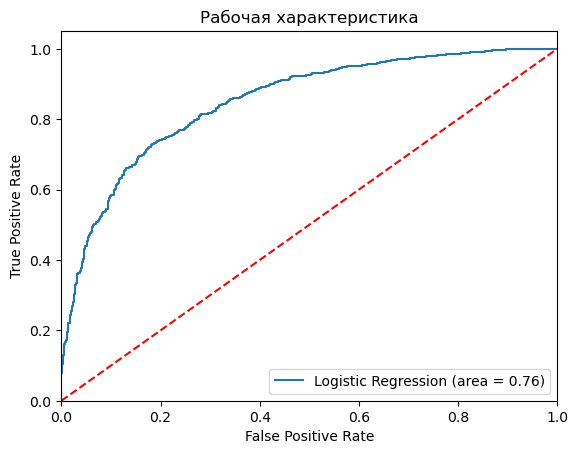

In [37]:
# Обучение модели логистической регрессии
logreg = LogisticRegression(max_iter=1000, random_state=42)
logreg.fit(X_train, y_train)

# посмотрим метрики
check_metrics_log_regress(X_train, y_train, X_test, y_test)

<div style="border:solid green 2px; padding: 20px"> 
<b>Вывод по логистической регрессии:</b> 
    
Модель выдала ROC AUC на сырых данных 0.74. В итоге из начального массива X мы берем для модели столбцы 0,1,2,3,4 и получаем ROC AUC 0.76.

</div>

## Задание 3

В этом задании сравним алгоритм Random Forest с логистической регрессией. Обучим две модели, подобрав гиперпараметры на отделенной от трейна валидационной выборке.

 - на всех признаках из изначального датасета (на сырых данных)
 - на признаках, на которых вы строили логрег (после удаления неинформативных признаков и линеаризации остальных)

Насколько сильнее (или наоборот слабее) показали себя "деревянные модели" по сравнению с линейными? Помогла ли предобработка переменных улучшить качество случайного леса?

# Построение случайного леса

### Построение Random Forest на сырых данных с дефолтными гиперпараметрами

In [38]:
rfc_row_def = RandomForestClassifier(random_state=42)
rfc_row_def.fit(X_train_f, y_train)

pred_train = rfc_row_def.predict_proba(X_train_f)[:, 1]  # Вероятности класса 1 для обучающего набора
pred_test = rfc_row_def.predict_proba(X_test_f)[:, 1]  # Вероятности класса 1 для тестового набора

print((
    f"ROC AUC на обучающей выборке: {roc_auc_score(y_train, pred_train):.3f}\n"
    f"ROC AUC на тестовой выборке:  {roc_auc_score(y_test, pred_test):.3f}"
))

ROC AUC на обучающей выборке: 1.000
ROC AUC на тестовой выборке:  0.932


Случайный лес все равно переобучился. Об этом свидетельствует AUC = 1 на обучающей выборке. 

Переобучение означает, что модель подстроилась под шум в данных, а не под реальную взаимосвязь признаков и целевой переменной. Посмотрим, насколько важны для модели неинформативные признаки. Для этого расчитаем важность переменных для модели, feature importances.

In [39]:
non_informative = roc_auc_individual_features(X_train_f, y_train)

0 : auc = 0.495 -> non_informative
1 : auc = 0.743
2 : auc = 0.714
3 : auc = 0.404
4 : auc = 0.501 -> non_informative
5 : auc = 0.466
6 : auc = 0.387
7 : auc = 0.493 -> non_informative
8 : auc = 0.508 -> non_informative
9 : auc = 0.504 -> non_informative
10 : auc = 0.496 -> non_informative
11 : auc = 0.506 -> non_informative
12 : auc = 0.495 -> non_informative
13 : auc = 0.502 -> non_informative
14 : auc = 0.492 -> non_informative
15 : auc = 0.493 -> non_informative
16 : auc = 0.503 -> non_informative
17 : auc = 0.503 -> non_informative
18 : auc = 0.497 -> non_informative
19 : auc = 0.505 -> non_informative


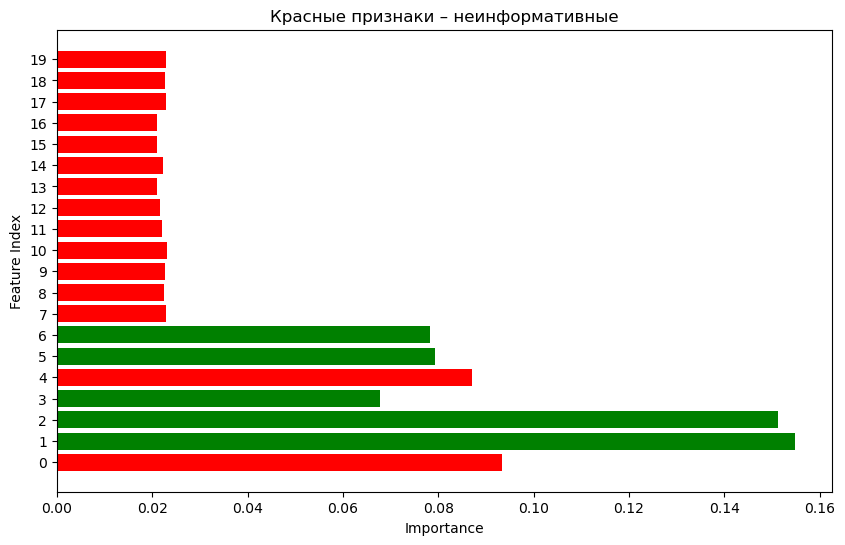

In [40]:
# получение feature_importances_
feature_importances = rfc_row_def.feature_importances_

# Визуализация важности признаков
plt.figure(figsize=(10, 6))
(plt.barh(range(len(feature_importances)), feature_importances, 
          color=["green" if feat not in non_informative else "red" for feat in np.arange(20)])
)
plt.yticks(range(len(feature_importances)), range(X.shape[1]))
plt.xlabel('Importance')
plt.ylabel('Feature Index')
plt.title('Красные признаки – неинформативные')
plt.show()

Видим, что два неинформативных признака модель учитывает достаточно сильно. Причем оба одни из важнейших для модели.

### Построение Random Forest на сырых данных с измененными гиперпараметрами

Будем заниматься подбором следующих гиперпараметров:

- n_estimators — число «деревьев» в «случайном лесу».
- max_features — число признаков для выбора расщепления.
- max_depth — максимальная глубина деревьев.
- min_samples_split — минимальное число объектов, необходимое для того, чтобы узел дерева мог бы расщепиться.
- min_samples_leaf — минимальное число объектов в листьях.
- bootstrap — использование для построения деревьев подвыборки с возвращением.

In [41]:
rs_df = RandomizedSearchCV_params(rfc_row_def, X_train_f, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
{'n_estimators': 700, 'min_samples_split': 12, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': 13, 'bootstrap': False}


Теперь создадим столбчатые графики, на которых, по оси Х, расположены значения гиперпараметров, а по оси Y — средние значения, показываемые моделями. Это позволит понять то, какие значения гиперпараметров, в среднем, лучше всего себя показывают.

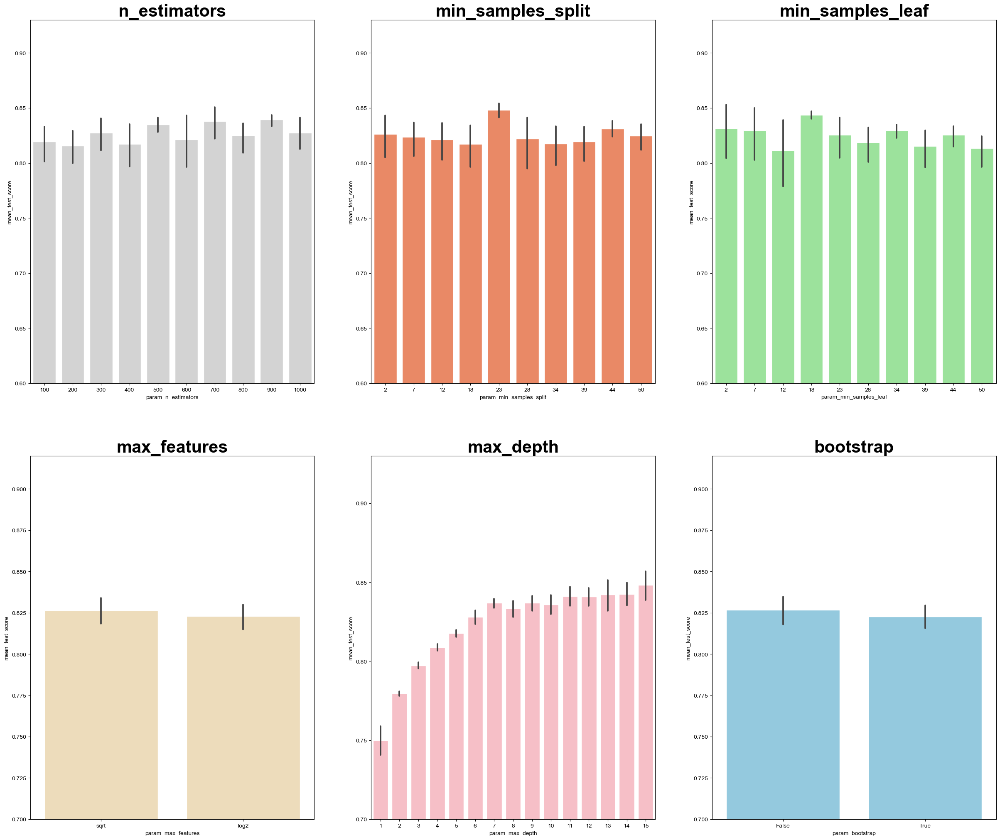

In [42]:
fig, axs = plt.subplots(ncols=3, nrows=2)
sns.set(style="whitegrid", color_codes=True, font_scale=2)
fig.set_size_inches(30, 25)

# n_estimators
sns.barplot(x='param_n_estimators', y='mean_test_score', data=rs_df, ax=axs[0, 0], color='lightgrey')
axs[0, 0].set_ylim([.6, .93])
axs[0, 0].set_title(label='n_estimators', size=30, weight='bold')

# param_min_samples_split
sns.barplot(x='param_min_samples_split', y='mean_test_score', data=rs_df, ax=axs[0, 1], color='coral')
axs[0, 1].set_ylim([.6, .93])
axs[0, 1].set_title(label='min_samples_split', size=30, weight='bold')

# min_samples_leaf
sns.barplot(x='param_min_samples_leaf', y='mean_test_score', data=rs_df, ax=axs[0, 2], color='lightgreen')
axs[0, 2].set_ylim([.6, .93])
axs[0, 2].set_title(label='min_samples_leaf', size=30, weight='bold')

# max_features
sns.barplot(x='param_max_features', y='mean_test_score', data=rs_df, ax=axs[1, 0], color='wheat')
axs[1, 0].set_ylim([.7, .92])
axs[1, 0].set_title(label='max_features', size=30, weight='bold')

# max_depth
sns.barplot(x='param_max_depth', y='mean_test_score', data=rs_df, ax=axs[1, 1], color='lightpink')
axs[1, 1].set_ylim([.7, .93])
axs[1, 1].set_title(label='max_depth', size=30, weight='bold')

# bootstrap
sns.barplot(x='param_bootstrap', y='mean_test_score', data=rs_df, ax=axs[1, 2], color='skyblue')
axs[1, 2].set_ylim([.7, .92])
axs[1, 2].set_title(label='bootstrap', size=30, weight='bold')
plt.show()


Если проанализировать вышеприведённые графики, то можно заметить некоторые интересные вещи, говорящие о том, как, в среднем, каждое значение гиперпараметра влияет на модель.

- n_estimators: значения 500, 700, 900, видимо, показывают наилучшие средние результаты.
- min_samples_split: хорошо выглядит значение 23 и 28. Можно исследовать несколько значений этого гиперпараметра, например 23 и 28, а также — 44.
- min_samples_leaf: маленькие значения этого гиперпараметра дают более высокие результаты. А это значит, что мы можем испытать значения 2,7 и 18.
- max_features: вариант sqrt даёт самый высокий средний результат.
- max_depth: видна зависимость, проверим значения 13, 14, 15.
- bootstrap: значение False показывает наилучший средний результат.

Теперь мы, воспользовавшись значениями выше, можем перейти ко второму раунду оптимизации гиперпараметров. Это позволит сузить спектр интересующих нас значений.

In [44]:
n_estimators = [500,700,900]
max_features = ['sqrt']
max_depth = [13,14,15]
min_samples_split = [23,28,44]
min_samples_leaf = [2,7,18]
bootstrap = [False]
param_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
gs = GridSearchCV(rfc_row_def, param_grid, cv = 3, verbose = 1, n_jobs=-1)
gs.fit(X_train_f, y_train)
rfc_row_def = gs.best_estimator_
gs.best_params_

Fitting 3 folds for each of 81 candidates, totalling 243 fits


{'bootstrap': False,
 'max_depth': 15,
 'max_features': 'sqrt',
 'min_samples_leaf': 2,
 'min_samples_split': 23,
 'n_estimators': 900}

Теперь проверим ROC AUC с измененными гиперпараметрами.

In [45]:
pred_train_gs = gs.best_estimator_.predict(X_train_f)
pred_test_gs = gs.best_estimator_.predict(X_test_f)
print((
    f"ROC AUC на обучающей выборке: {roc_auc_score(y_train, pred_train_gs):.3f}\n"
    f"ROC AUC на тестовой выборке:  {roc_auc_score(y_test, pred_test_gs):.3f}"
))

ROC AUC на обучающей выборке: 0.972
ROC AUC на тестовой выборке:  0.865


### Построение Random Forest на очищенных данных для лог. рег. с дефолтными гиперпараметрами

In [46]:
rfc_regress_def = RandomForestClassifier(random_state=42)
rfc_regress_def.fit(X_train, y_train)

pred_train = rfc_regress_def.predict_proba(X_train)[:, 1]  # Вероятности класса 1 для обучающего набора
pred_test = rfc_regress_def.predict_proba(X_test)[:, 1]  # Вероятности класса 1 для тестового набора

print((
    f"ROC AUC на обучающей выборке: {roc_auc_score(y_train, pred_train):.3f}\n"
    f"ROC AUC на тестовой выборке:  {roc_auc_score(y_test, pred_test):.3f}"
))

ROC AUC на обучающей выборке: 1.000
ROC AUC на тестовой выборке:  0.902


Случайный лес все равно переобучился. Об этом свидетельствует AUC = 1 на обучающей выборке. Но результат на тесте хуже чем при сырых данных.

 Посмотрим, насколько важны для модели неинформативные признаки. Для этого расчитаем важность переменных для модели, feature importances.

In [47]:
non_informative = roc_auc_individual_features(X_train, y_train)

0 : auc = 0.378
1 : auc = 0.744
2 : auc = 0.715
3 : auc = 0.404
4 : auc = 0.598


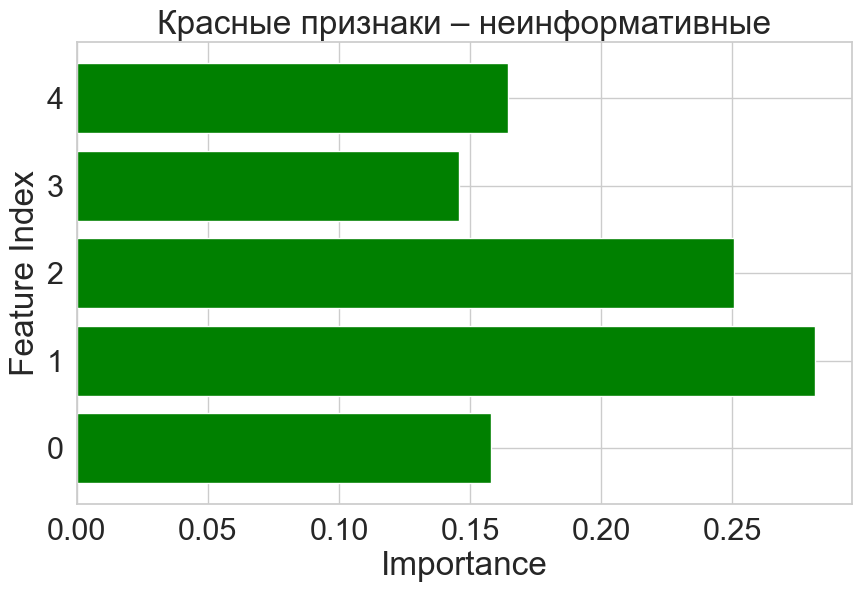

In [48]:
# получение feature_importances_
feature_importances = rfc_regress_def.feature_importances_

# Визуализация важности признаков
plt.figure(figsize=(10, 6))
(plt.barh(range(len(feature_importances)), feature_importances, 
          color=["green" if feat not in non_informative else "red" for feat in np.arange(5)])
)
plt.yticks(range(len(feature_importances)), range(X_train.shape[1]))
plt.xlabel('Importance')
plt.ylabel('Feature Index')
plt.title('Красные признаки – неинформативные')
plt.show()

###  Построение Random Forest на очищенных данных для лог. рег. с измененными гиперпараметрами

In [49]:
rs_df = RandomizedSearchCV_params(rfc_regress_def, X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
{'n_estimators': 700, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 'log2', 'max_depth': 11, 'bootstrap': True}


Теперь создадим столбчатые графики, на которых, по оси Х, расположены значения гиперпараметров, а по оси Y — средние значения, показываемые моделями. Это позволит понять то, какие значения гиперпараметров, в среднем, лучше всего себя показывают.

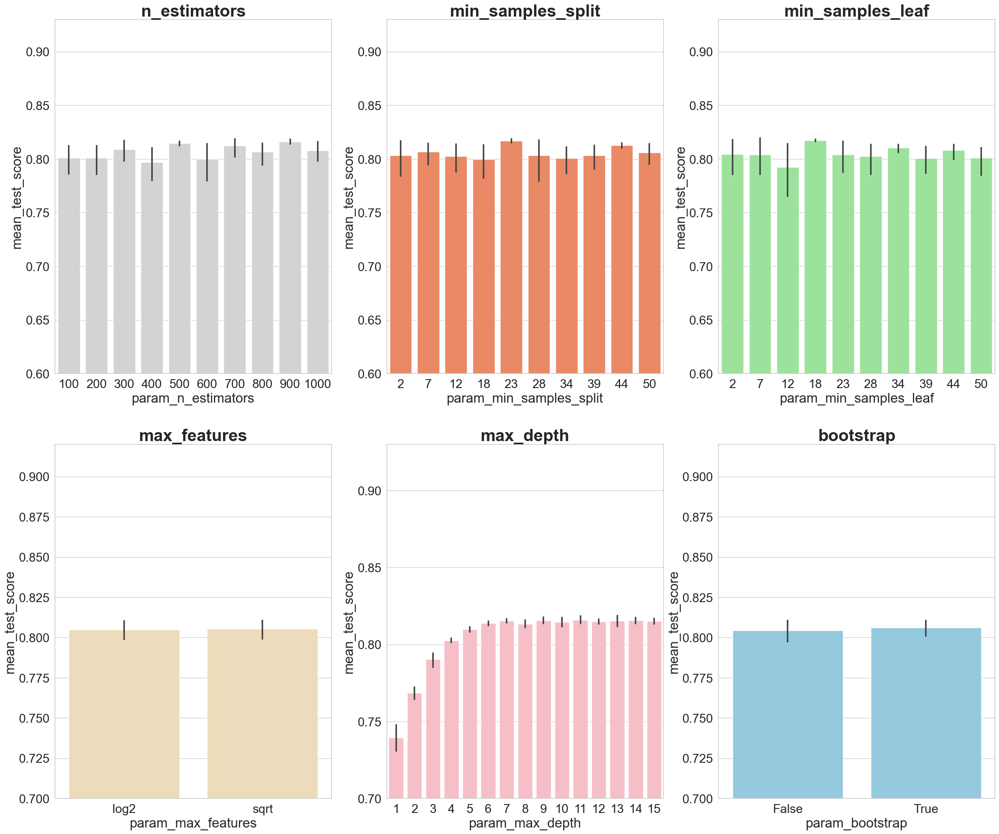

In [50]:
fig, axs = plt.subplots(ncols=3, nrows=2)
sns.set(style="whitegrid", color_codes=True, font_scale=2)
fig.set_size_inches(30, 25)

# n_estimators
sns.barplot(x='param_n_estimators', y='mean_test_score', data=rs_df, ax=axs[0, 0], color='lightgrey')
axs[0, 0].set_ylim([.6, .93])
axs[0, 0].set_title(label='n_estimators', size=30, weight='bold')

# param_min_samples_split
sns.barplot(x='param_min_samples_split', y='mean_test_score', data=rs_df, ax=axs[0, 1], color='coral')
axs[0, 1].set_ylim([.6, .93])
axs[0, 1].set_title(label='min_samples_split', size=30, weight='bold')

# min_samples_leaf
sns.barplot(x='param_min_samples_leaf', y='mean_test_score', data=rs_df, ax=axs[0, 2], color='lightgreen')
axs[0, 2].set_ylim([.6, .93])
axs[0, 2].set_title(label='min_samples_leaf', size=30, weight='bold')

# max_features
sns.barplot(x='param_max_features', y='mean_test_score', data=rs_df, ax=axs[1, 0], color='wheat')
axs[1, 0].set_ylim([.7, .92])
axs[1, 0].set_title(label='max_features', size=30, weight='bold')

# max_depth
sns.barplot(x='param_max_depth', y='mean_test_score', data=rs_df, ax=axs[1, 1], color='lightpink')
axs[1, 1].set_ylim([.7, .93])
axs[1, 1].set_title(label='max_depth', size=30, weight='bold')

# bootstrap
sns.barplot(x='param_bootstrap', y='mean_test_score', data=rs_df, ax=axs[1, 2], color='skyblue')
axs[1, 2].set_ylim([.7, .92])
axs[1, 2].set_title(label='bootstrap', size=30, weight='bold')
plt.show()

Если проанализировать вышеприведённые графики, то можно заметить некоторые интересные вещи, говорящие о том, как, в среднем, каждое значение гиперпараметра влияет на модель.

- n_estimators: значения 500, 700, 900, видимо, показывают наилучшие средние результаты.
- min_samples_split: хорошо выглядит значение 23 и 28. Можно исследовать несколько значений этого гиперпараметра, например 23 и 28, а также — 44.
- min_samples_leaf: маленькие значения этого гиперпараметра дают более высокие результаты. А это значит, что мы можем испытать значения 2,7 и 18.
- max_features: вариант sqrt даёт самый высокий средний результат.
- max_depth: видна зависимость, проверим значения 13, 14, 15.
- bootstrap: значение True показывает наилучший средний результат.

Теперь мы, воспользовавшись значениями выше, можем перейти ко второму раунду оптимизации гиперпараметров. Это позволит сузить спектр интересующих нас значений.

In [51]:
n_estimators = [500,700,900]
max_features = ['sqrt']
max_depth = [13,14,15]
min_samples_split = [23,28,44]
min_samples_leaf = [2,7,18]
bootstrap = [False, True]
param_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
gs = GridSearchCV(rfc_regress_def, param_grid, cv = 3, verbose = 1, n_jobs=-1)
gs.fit(X_train, y_train)
rfc_regress_def = gs.best_estimator_
gs.best_params_

Fitting 3 folds for each of 162 candidates, totalling 486 fits


{'bootstrap': True,
 'max_depth': 13,
 'max_features': 'sqrt',
 'min_samples_leaf': 2,
 'min_samples_split': 23,
 'n_estimators': 700}

Теперь просверим ROC AUC с измененными параметрами

In [52]:
pred_train_gs = gs.best_estimator_.predict(X_train)
pred_test_gs = gs.best_estimator_.predict(X_test)
print((
    f"ROC AUC на обучающей выборке: {roc_auc_score(y_train, pred_train_gs):.3f}\n"
    f"ROC AUC на тестовой выборке:  {roc_auc_score(y_test, pred_test_gs):.3f}"
))

ROC AUC на обучающей выборке: 0.892
ROC AUC на тестовой выборке:  0.821


<div style="border:solid green 2px; padding: 20px"> 
<b>Вывод по Random Forest:</b> 
    
Модель выдала ROC AUC на сырых данных c дефолтными гиперпараметрами:
- ROC AUC на обучающей выборке: 1.000
- ROC AUC на тестовой выборке:  0.932

Модель выдала ROC AUC на сырых данных c измененными гиперпараметрами:
- ROC AUC на обучающей выборке: 0.972
- ROC AUC на тестовой выборке:  0.865

Модель выдала ROC AUC на очищенных данных для лог. регресии c дефолтными гиперпараметрами:
- ROC AUC на обучающей выборке: 1.000
- ROC AUC на тестовой выборке:  0.902
    
Модель выдала ROC AUC на очищенных данных для лог. регресии c измененными гиперпараметрами:
- ROC AUC на обучающей выборке: 0.892
- ROC AUC на тестовой выборке:  0.821
</div>

<div style="border:solid green 2px; padding: 20px"> 
<b> Общий вывод:</b> 
    
Random Forest показал результат лучше, чем логистическая регрессия. Предобработка переменных и подбор гиперпараметров ухудшили результаты Random Forest, но улучшили результаты логистической регрессии. В итоге лучший результат у Random Forest с дефолтными параметрами и без предобработки переменных.
</div>